In [21]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import altair as alt
import geopandas 
import geodatasets
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import folium

# Loading The Airbnb Data

In [23]:
data = pd.read_csv('listings.csv')

In [28]:
airbnb = pd.read_csv('listings.csv')
airbnb.head()
airbnb['property_type'].unique()
airbnb['property_type'].fillna("Other", inplace = True)
airbnb['property_type'].unique()

array(['House', 'Apartment', 'Condominium', 'Villa', 'Bed & Breakfast',
       'Townhouse', 'Entire Floor', 'Loft', 'Guesthouse', 'Boat', 'Dorm',
       'Other', 'Camper/RV'], dtype=object)

# Data for D3 Property Type vs. Number of Accommodates Barchart               

## Get max number of accommodates in each unique property type

In [29]:
accoms = []
group = airbnb.groupby('property_type')

df2 = group.apply(lambda x: max(x['accommodates']))

df = df2.to_frame()

accoms = df2.tolist()
accoms

[14, 8, 10, 7, 10, 3, 6, 4, 16, 7, 4, 14, 4]

In [30]:
props = sorted(airbnb['property_type'].unique())
props

['Apartment',
 'Bed & Breakfast',
 'Boat',
 'Camper/RV',
 'Condominium',
 'Dorm',
 'Entire Floor',
 'Guesthouse',
 'House',
 'Loft',
 'Other',
 'Townhouse',
 'Villa']

In [31]:
final_df = list(zip(props, accoms))

df = pd.DataFrame(final_df,
                  columns=['property_type', 'accommodations'])
df

,property_type,accommodations
0,Apartment,14
1,Bed & Breakfast,8
2,Boat,10
3,Camper/RV,7
4,Condominium,10
5,Dorm,3
6,Entire Floor,6
7,Guesthouse,4
8,House,16
9,Loft,7


In [32]:
df.to_csv('listings1.csv') #convert to csv to be used in D3

# Static Visualization #1:  Histogram

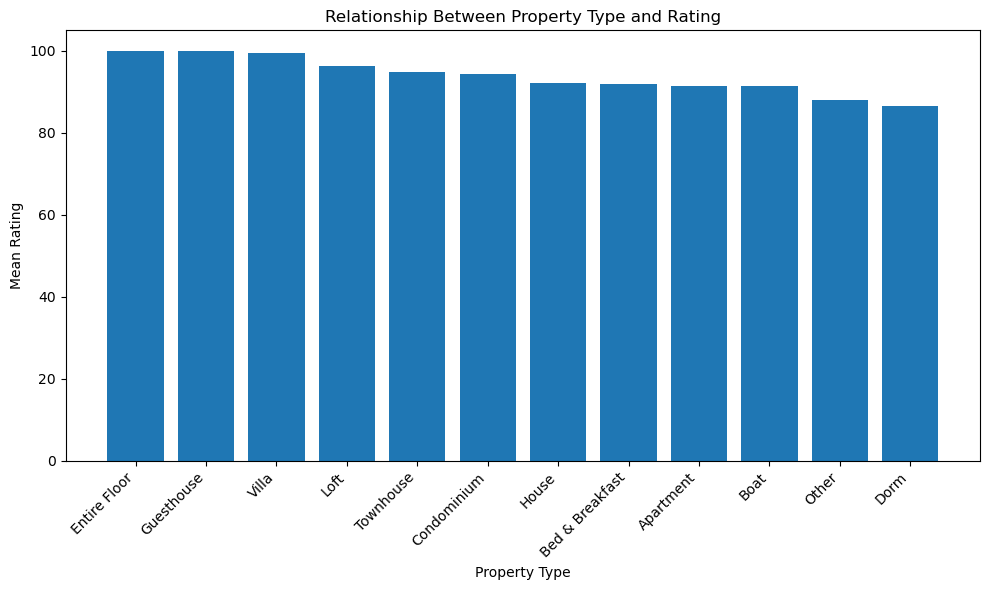

In [24]:
data_filtered = data.dropna(subset=['property_type', 'review_scores_rating'])

# Group by 'property_type' and calculate the mean rating
property_rating = data_filtered.groupby('property_type')['review_scores_rating'].mean().reset_index()

# Sort by mean rating in descending order
property_rating_sorted = property_rating.sort_values(by='review_scores_rating', ascending=False)


# Create the histogram with custom colors
plt.figure(figsize=(10, 6))
bars = plt.bar(property_rating_sorted['property_type'], property_rating_sorted['review_scores_rating'])
plt.xlabel('Property Type')
plt.ylabel('Mean Rating')
plt.title('Relationship Between Property Type and Rating')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()

plt.show()

# Static Visualization #2:  Boxplot

/var/folders/g7/3q54ywz91zg5npm_5kkqnnpm0000gn/T/ipykernel_98203/3947382674.py:2: FutureWarning: The default value of regex will change from True to False in a future version.
  listings['price'] = pd.to_numeric(listings['price'].str.replace('[^\d.]', ''), errors='coerce')


<Figure size 1000x600 with 0 Axes>

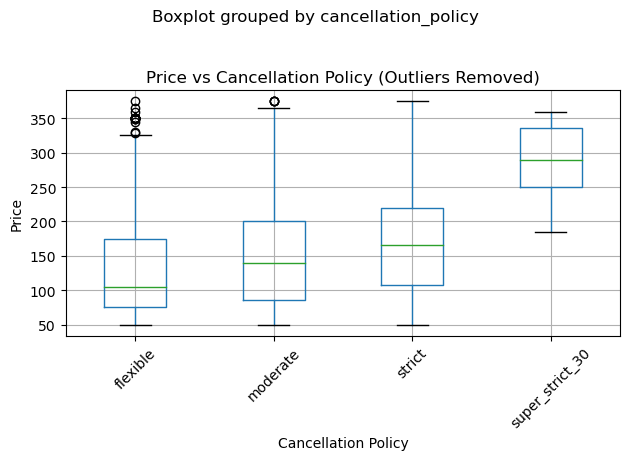

In [35]:
listings= pd.read_csv('listings.csv')
listings['price'] = pd.to_numeric(listings['price'].str.replace('[^\d.]', ''), errors='coerce')
# Determine the upper and lower bounds for removing outliers
lower_bound = listings['price'].quantile(0.05)  # Adjust the quantile as needed
upper_bound = listings['price'].quantile(0.95)  # Adjust the quantile as needed

# Filter the data to remove outliers
filtered_listings = listings[(listings['price'] >= lower_bound) & (listings['price'] <= upper_bound)]

# Plot boxplot with the filtered data
plt.figure(figsize=(10, 6))
filtered_listings.boxplot(column='price', by='cancellation_policy')
plt.title('Price vs Cancellation Policy (Outliers Removed)')
plt.xlabel('Cancellation Policy')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

# Static Visualization #3:  Boxplot

Clean up price column by removing commas and dollar signs and converting to a float

In [33]:
airbnb['price'] = airbnb['price'].map(lambda x: x.lstrip('$'))
airbnb['price'] = airbnb['price'].str.replace(',', '')
airbnb['price'] = airbnb['price'].astype(float)

Find outliers in the price column and remove them

In [ ]:
def find_outlier(df, column):
    # Find first and third quartile
    q1 = df[column].quantile(0.25)
    q3 = df[column].quantile(0.75)
    
    # Find interquartile range
    IQR = q3 - q1
    
    # Find lower and upper bound
    lower_bound = q1 - 1.5 * IQR
    upper_bound = q3 + 1.5 * IQR
    
    # Remove outliers
    df[column] = df[column][df[column] > lower_bound]
    df[column] = df[column][df[column] < upper_bound]
    
    return df[column]

airbnb['price'] = find_outlier(airbnb, 'price')
airbnb['price'].max()

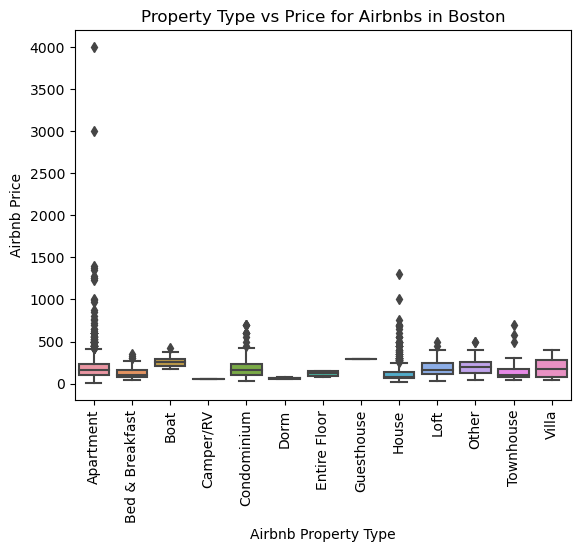

In [34]:
sns.boxplot(x = airbnb['property_type'].sort_values(), y = airbnb['price'])
plt.xticks(rotation=90)

plt.xlabel('Airbnb Property Type')
plt.ylabel('Airbnb Price')
plt.title('Property Type vs Price for Airbnbs in Boston')

# Show the plot
plt.savefig("airbnb.pdf", format="pdf")
plt.show()

# Interactive Visualization #1:  Interactive Map of Boston

In [11]:
from shapely.geometry import Point
from pyproj import CRS


geometry = [Point(xy) for xy in zip(listings['latitude'],
                                                 listings['longitude'])]
listings_new = geopandas.GeoDataFrame(listings, geometry=geometry, crs=CRS.from_epsg(4326))

listings_new.head()

,id,listing_url,scrape_id,last_scraped,name,summary,space,description,experiences_offered,neighborhood_overview,...,requires_license,license,jurisdiction_names,instant_bookable,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,reviews_per_month,geometry
0,12147973,https://www.airbnb.com/rooms/12147973,20160906204935,2016-09-07,Sunny Bungalow in the City,"Cozy, sunny, family home. Master bedroom high...",The house has an open and cozy feel at the sam...,"Cozy, sunny, family home. Master bedroom high...",none,"Roslindale is quiet, convenient and friendly. ...",...,f,NaN,NaN,f,moderate,f,f,1,NaN,POINT (42.28262 -71.13307)
1,3075044,https://www.airbnb.com/rooms/3075044,20160906204935,2016-09-07,Charming room in pet friendly apt,Charming and quiet room in a second floor 1910...,Small but cozy and quite room with a full size...,Charming and quiet room in a second floor 1910...,none,"The room is in Roslindale, a diverse and prima...",...,f,NaN,NaN,t,moderate,f,f,1,1.30,POINT (42.28624 -71.13437)
2,6976,https://www.airbnb.com/rooms/6976,20160906204935,2016-09-07,Mexican Folk Art Haven in Boston,"Come stay with a friendly, middle-aged guy in ...","Come stay with a friendly, middle-aged guy in ...","Come stay with a friendly, middle-aged guy in ...",none,The LOCATION: Roslindale is a safe and diverse...,...,f,NaN,NaN,f,moderate,t,f,1,0.47,POINT (42.29244 -71.13577)
3,1436513,https://www.airbnb.com/rooms/1436513,20160906204935,2016-09-07,Spacious Sunny Bedroom Suite in Historic Home,Come experience the comforts of home away from...,Most places you find in Boston are small howev...,Come experience the comforts of home away from...,none,Roslindale is a lovely little neighborhood loc...,...,f,NaN,NaN,f,moderate,f,f,1,1.00,POINT (42.28111 -71.12102)
4,7651065,https://www.airbnb.com/rooms/7651065,20160906204935,2016-09-07,Come Home to Boston,"My comfy, clean and relaxing home is one block...","Clean, attractive, private room, one block fro...","My comfy, clean and relaxing home is one block...",none,"I love the proximity to downtown, the neighbor...",...,f,NaN,NaN,f,flexible,f,f,1,2.25,POINT (42.28451 -71.13626)


In [12]:
state = geopandas.read_file("ne_110m_admin_1_states_provinces/ne_110m_admin_1_states_provinces.shp")
state.head()

,featurecla,scalerank,adm1_code,diss_me,iso_3166_2,wikipedia,iso_a2,adm0_sr,name,name_alt,...,FCLASS_ID,FCLASS_PL,FCLASS_GR,FCLASS_IT,FCLASS_NL,FCLASS_SE,FCLASS_BD,FCLASS_UA,FCLASS_TLC,geometry
0,Admin-1 scale rank,2,USA-3514,3514,US-MN,http://en.wikipedia.org/wiki/Minnesota,US,1,Minnesota,MN|Minn.,...,None,None,None,None,None,None,None,None,None,"POLYGON ((-89.95766 47.28691, -90.13175 47.292..."
1,Admin-1 scale rank,2,USA-3515,3515,US-MT,http://en.wikipedia.org/wiki/Montana,US,1,Montana,MT|Mont.,...,None,None,None,None,None,None,None,None,None,"POLYGON ((-116.04823 49.00037, -113.05950 49.0..."
2,Admin-1 scale rank,2,USA-3516,3516,US-ND,http://en.wikipedia.org/wiki/North_Dakota,US,1,North Dakota,ND|N.D.,...,None,None,None,None,None,None,None,None,None,"POLYGON ((-97.22894 49.00089, -97.21414 48.902..."
3,Admin-1 scale rank,2,USA-3517,3517,US-HI,http://en.wikipedia.org/wiki/Hawaii,US,8,Hawaii,HI|Hawaii,...,None,None,None,None,None,None,None,None,None,"MULTIPOLYGON (((-155.93665 19.05939, -155.9080..."
4,Admin-1 scale rank,2,USA-3518,3518,US-ID,http://en.wikipedia.org/wiki/Idaho,US,1,Idaho,ID|Idaho,...,None,None,None,None,None,None,None,None,None,"POLYGON ((-116.04823 49.00037, -115.96780 47.9..."


In [13]:
county = geopandas.read_file("ne_10m_admin_2_counties/ne_10m_admin_2_counties.shp")
county.head()

,FEATURECLA,SCALERANK,ADM2_CODE,ISO_3166_2,ISO_A2,ADM0_SR,NAME,NAME_ALT,NAME_LOCAL,TYPE,...,NAME_PT,NAME_RU,NAME_SV,NAME_TR,NAME_UK,NAME_UR,NAME_VI,NAME_ZH,NAME_ZHT,geometry
0,Admin-2 scale rank,0,USA-53073,US-53,US,1,Whatcom,Whatcom County,None,County,...,Whatcom,Уотком,Whatcom,Whatcom,Вотком,واٹکم کاؤنٹی، واشنگٹن,Whatcom,霍特科姆县,霍特科姆縣,"MULTIPOLYGON (((-122.75302 48.99251, -122.6532..."
1,Admin-2 scale rank,0,USA-53047,US-53,US,1,Okanogan,Okanogan County,None,County,...,Okanogan,Оканоган,Okanogan,Okanogan,Оканоґан,اوکاناگن کاؤنٹی، واشنگٹن,Okanogan,奥卡诺根县,奧卡諾根縣,"POLYGON ((-120.85196 48.99251, -120.67495 48.9..."
2,Admin-2 scale rank,0,USA-53019,US-53,US,1,Ferry,Ferry County,None,County,...,Ferry,Ферри,Ferry,Ferry,Феррі,فیری کاؤنٹی، واشنگٹن,Ferry,费里县,費里縣,"POLYGON ((-118.83688 48.99251, -118.69668 48.9..."
3,Admin-2 scale rank,0,USA-53065,US-53,US,1,Stevens,Stevens County,None,County,...,Stevens,Стивенс,Stevens,Stevens,Стівенс,سٹیونس کاؤنٹی، واشنگٹن,Stevens,史蒂文斯县,史蒂文斯縣,"POLYGON ((-118.21996 48.99251, -118.03723 48.9..."
4,Admin-2 scale rank,0,USA-53051,US-53,US,1,Pend Oreille,Pend Oreille County,None,County,...,Pend Oreille,Панд-Орей,Pend Oreille,Pend Oreille,Понд-Орей,پینڈ اورائل کاؤنٹی، واشنگٹن,Pend Oreille,庞多雷县,龐多雷縣,"POLYGON ((-117.42951 48.99251, -117.37787 48.9..."


<Axes: >

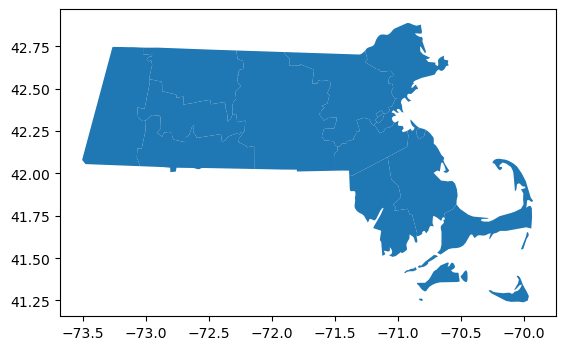

In [14]:
MA = county[county['ISO_3166_2'] == "US-25"]

MA.plot()

In [15]:
point_airbnb = listings_new.explode(index_parts=True)
point_airbnb.head()

,,id,listing_url,scrape_id,last_scraped,name,summary,space,description,experiences_offered,neighborhood_overview,...,requires_license,license,jurisdiction_names,instant_bookable,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,reviews_per_month,geometry
0,0,12147973,https://www.airbnb.com/rooms/12147973,20160906204935,2016-09-07,Sunny Bungalow in the City,"Cozy, sunny, family home. Master bedroom high...",The house has an open and cozy feel at the sam...,"Cozy, sunny, family home. Master bedroom high...",none,"Roslindale is quiet, convenient and friendly. ...",...,f,NaN,NaN,f,moderate,f,f,1,NaN,POINT (42.28262 -71.13307)
1,0,3075044,https://www.airbnb.com/rooms/3075044,20160906204935,2016-09-07,Charming room in pet friendly apt,Charming and quiet room in a second floor 1910...,Small but cozy and quite room with a full size...,Charming and quiet room in a second floor 1910...,none,"The room is in Roslindale, a diverse and prima...",...,f,NaN,NaN,t,moderate,f,f,1,1.30,POINT (42.28624 -71.13437)
2,0,6976,https://www.airbnb.com/rooms/6976,20160906204935,2016-09-07,Mexican Folk Art Haven in Boston,"Come stay with a friendly, middle-aged guy in ...","Come stay with a friendly, middle-aged guy in ...","Come stay with a friendly, middle-aged guy in ...",none,The LOCATION: Roslindale is a safe and diverse...,...,f,NaN,NaN,f,moderate,t,f,1,0.47,POINT (42.29244 -71.13577)
3,0,1436513,https://www.airbnb.com/rooms/1436513,20160906204935,2016-09-07,Spacious Sunny Bedroom Suite in Historic Home,Come experience the comforts of home away from...,Most places you find in Boston are small howev...,Come experience the comforts of home away from...,none,Roslindale is a lovely little neighborhood loc...,...,f,NaN,NaN,f,moderate,f,f,1,1.00,POINT (42.28111 -71.12102)
4,0,7651065,https://www.airbnb.com/rooms/7651065,20160906204935,2016-09-07,Come Home to Boston,"My comfy, clean and relaxing home is one block...","Clean, attractive, private room, one block fro...","My comfy, clean and relaxing home is one block...",none,"I love the proximity to downtown, the neighbor...",...,f,NaN,NaN,f,flexible,f,f,1,2.25,POINT (42.28451 -71.13626)


In [17]:
m = MA.explore( 
    tooltip = 'NAME',  
    scheme = 'quantiles',
    legend = True, 
    name = 'Massachusetts'
)

point_airbnb.explore(
    m = m, 
    color = "blue", 
    marker_kwds = dict(radius = 3, fill = True), 
    tooltip = ['property_type', 'price'],
    tooltip_kwds = dict(labels = False), 
    name = "airbnb"
)

folium.TileLayer("CartoDB positron", show = False).add_to(m)
folium.LayerControl().add_to(m)

m

In [18]:
from folium.plugins import MarkerCluster

m = folium.Map(location=[42.3601, -71.0589], zoom_start=12)

# Add Boston boundary to the map
folium.GeoJson(MA).add_to(m)

# Create a MarkerCluster layer for Airbnb data
marker_cluster = MarkerCluster().add_to(m)

property_type_color = {
    'Apartment': 'blue',
    'House': 'green',
    'Condo': 'red',}
    
# Add Airbnb locations to the MarkerCluster layer
for idx, row in listings_new.iterrows():
    property_color = property_type_color.get(row['property_type'], 'gray'),
    folium.CircleMarker(location=[row['latitude'], row['longitude']],
                        radius=3,
                        fill=True,
                        color=property_color,
                        tooltip=f"Property Type: {row['property_type']}, Price: {row['price']}"
                        ).add_to(marker_cluster)

# Add CartoDB positron tile layer
folium.TileLayer("CartoDB positron", show=False).add_to(m)

# Add layer control
folium.LayerControl().add_to(m)

# Display the map
m

# Interactive Visualization #2:  Scatterplot
Scatterplot showing the relationship between the number of accommodates, rating, and price, to determine if a higher number of accommodates living at the Airbnb contributes to a higher price
Drop down menu to select the number of accommodates

In [27]:
import pandas as pd
import numpy as np
import altair as alt

# Read data files
listings_df = pd.read_csv("listings.csv")
reviews_df = pd.read_csv("reviews.csv")

# Merge the two dataframes based on 'listing_id'
merged_df = pd.merge(listings_df, reviews_df, left_on='id', right_on='listing_id', how='inner')

# Select only the specified columns
merged_df = merged_df[['listing_id', 'accommodates', 'price', 'review_scores_rating']]

# Remove duplicate rows based on 'listing_id'
merged_df = merged_df.drop_duplicates(subset=['listing_id'])

# Optionally, reset index
merged_df.reset_index(drop=True, inplace=True)

# Convert 'price' column to numerical format
merged_df['price'] = merged_df['price'].replace('[\$,]', '', regex=True).astype(float)

# Handle missing values in 'review_scores_rating' column by filling with the mean
mean_rating = merged_df['review_scores_rating'].mean()
merged_df['review_scores_rating'].fillna(mean_rating, inplace=True)

# Calculate Z-score for 'price' column
z_scores = (merged_df['price'] - merged_df['price'].mean()) / merged_df['price'].std()

# Define threshold for outliers (e.g., z-score > 3 or < -3)
threshold = 3

# Remove outliers
merged_df = merged_df[(np.abs(z_scores) < threshold)]

# Create Altair scatterplot
scatter_plot = alt.Chart(merged_df).mark_circle().encode(
    x='accommodates:Q',
    y='price:Q',
    color=alt.Color('review_scores_rating:Q', scale=alt.Scale(scheme='paired')),
    tooltip=['accommodates', 'price', 'review_scores_rating']
).properties(
    width=600,
    height=400,
    title='Relationship between Number of Accommodates, Rating, and Price'
).interactive()

scatter_plot

alt.Chart(...)